This notebook is adapted from the June 24, 2020 EDA workshop provided by Data Circles.  I will be injecting my own EDA into the notebook that was originally created by Erin Orbits and Niwako Sigura.  The following is the work of Erin and Niwako.

# Exploratory Data Analysis Workshop

June 24, 2020  

#### Purpose of Workshop

- improve skills
- share experience
- join the project 

#### TAs for the Workshop

- Emily Glanz
- Shad Sharma
- Charlene Yan
- Vince Lugli

#### About Data Circles ([datacircles.org](https://datacircles.org))

Data Circles (formerly SeaWiDS) exists to provide a place for women in data science to connect, build community, support each other and grow. In less than two years Data Circles, has grown into a community with more than 1,800 members.   

Teams of volunteers organize monthly events in the Greater Seattle area, including: technical talks, informational panels, career development workshops, hackathons, conferences, networking events, book clubs, mentoring, study sessions, and interview prep.  

Likewise, presenters Niwako and Erin are members of the Data Circles Project Circle, and the Projects Circle is organizing the Traffic Collision Analysis project described below.  

The workshop materials can be found in the Data Circles [GitHub repository](https://github.com/datacircles). 

#### Other members of the Project Circle (moderators during the workshop)

- Erika Pelaez
- Houda Aynaou
- Sowmya Vasan
- Victoria Martin

## 1. Introduction to the project

Traffic collisions continue to be a serious problem. According to the [annual collision report for 2015](https://www.wsdot.wa.gov/mapsdata/crash/pdf/2015_Annual_Collision_Summary.pdf) released by the Washington State Dept. of Transportation (WSDOT), there were 117,053 collisions and approximately 59.7 billion miles driven. In 2015, there were  

* 5,576,586 Licensed drivers  
* 6,252,554 Registered vehicles  
* 416,699 Speeding citations  
* 33,697 Cell phone and texting citations   

In that same year:  

* Fridays had the most collisions;   
* December had the most crashes (on average, 401 per day); and  
* Driver inattention or distraction was the most frequent contributing factor  

Like the WSDOT, the Seattle Department of Transportation (SDOT) also publishes annual reports. For example, the [2019 TRAFFIC REPORT](http://www.seattle.gov/Documents/Departments/SDOT/VisionZero/2019_Traffic_Report.pdf) is based on data from January 1 to December 31, 2018. The report states that "Traffic volumes, speeds, and reported collisions are the three cardinal pieces of data traffic engineers and planners use to evaluate changes to Seattle streets."  

Accordingly, this project looks at recent collision data to consider how much things have changed. The primary goal of the project is to identify the most dangerous sections of road in Seattle and suggest improvements.  

Our data comes from the Seattle City GIS database, and for more information, see [seattlecitygis](https://data-seattlecitygis.opendata.arcgis.com/datasets/collisions).  

_**If you are interested in joining the project, please signup for the Project Kickoff event on [meetup.com](https://www.meetup.com/Seattle-WiDS-Meetup/events/ncnksrybckblb/).**_    

## 2. Purpose of exploratory data analysis (EDA)

EDA is a process for learning about datasets; looking for patterns, characteristics, or points of interest; answering questions; and visualizing the results. This requires the analyst:  
- to clean, reformat, and validate data;
- to visualize distributions and relationships between variables; and 
- to use regression models to predict and explain.  

Data exploration typically uses both manual data analysis and automated tools that extract data into initial reports that include data visualizations.  

Although EDA is the first step in the data analysis process, it should be repeated if additional data is added. Summarizing the size, accuracy and initial patterns in the data provides insight into potential trends and identifies areas for further analysis or data refinement. The end result provides a more useful view of the data to guide further analysis.  

### Project Specific Goals

The ultimate project goals include:  

1. Identify dangerous locations 
1. Identify predictors of accidents (e.g., physical characteristics of the location, road condition, DUI, weather)
1. Examine increase or decrease in number of accidents over time
1. Identify predictors of increase or decrease in the number of accidents
1. Recommend improvements on dangerous locations

- However, as you explore the dataset, other questions are likely to pop up in your head. 
- We recommend making a note of those questions as they may guide you through your project. 
- You are welcome to answer any questions you are interested in using this dataset.  

In light of these goals, we will walk through the initial data exploration process together. 

## 3. Import packages
In this section I will import the regular pakages that the original notebook contained as well as try using pandas profiling to examine the features.

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
#trying out pandas profiling....
from pandas_profiling import ProfileReport
%matplotlib inline

pd.options.display.max_rows = 500
pd.options.display.max_columns = 100

import warnings
warnings.filterwarnings("ignore") 

from datetime import datetime
from IPython.display import display, Markdown

In [2]:
# Run this cell to display all output within each cell in Jupyter Notebook, 
# instead of just the last statement

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [3]:
## To read a locally saved CSV file:

collisions = "collision_data_722020_raw.csv"  # or whatever your file name is
rdf = pd.read_csv(collisions, parse_dates=["INCDTTM"])

In [4]:
df = rdf.copy()

In [5]:
df.head()

,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,-122.316780,47.608643,1,331585,333085,3847763,Unmatched,Block,NaN,12TH AVE BETWEEN E CHERRY ST AND E COLUMBIA ST,,NaN,2,Injury Collision,NaN,3,0,0,0,1,0,0,2020/05/23 00:00:00+00,2020-05-23 00:00:00,Mid-Block (but intersection related),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,0,0,N
1,-122.322951,47.686787,2,27200,27200,527086,Matched,Intersection,24392.0,5TH AVE NE AND NE 80TH ST,NaN,NaN,1,Property Damage Only Collision,Angles,0,0,0,2,0,0,0,2004/02/04 00:00:00+00,2004-02-04 00:00:00,At Intersection (intersection related),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,0,Raining,Wet,Dark - Street Lights On,NaN,4035006.0,NaN,10,Entering at angle,0,0,N
2,-122.347162,47.613758,3,1107,1107,3562735,Matched,Block,NaN,1ST AVE BETWEEN BELL ST AND BATTERY ST,,NaN,1,Property Damage Only Collision,Parked Car,2,0,0,2,0,0,0,2013/03/28 00:00:00+00,2013-03-28 22:00:00,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,N,Clear,Unknown,Dark - Street Lights On,NaN,NaN,NaN,32,One parked--one moving,0,0,N
3,-122.273741,47.543815,4,58000,58000,2058206,Matched,Block,NaN,RAINIER AVE S BETWEEN S MORGAN ST AND S WARSAW ST,NaN,NaN,1,Property Damage Only Collision,Parked Car,2,0,0,2,0,0,0,2006/04/15 00:00:00+00,2006-04-15 12:00:00,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,0,Unknown,Unknown,Unknown,NaN,6105001.0,NaN,32,One parked--one moving,0,0,N
4,-122.337782,47.624690,5,331599,333099,3838130,Unmatched,Block,NaN,MERCER NR ST BETWEEN WESTLAKE AVE N AND TERRY ...,,NaN,1,Property Damage Only Collision,NaN,3,0,0,0,0,0,0,2020/05/22 00:00:00+00,2020-05-22 00:00:00,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,0,0,N


## 5. Look at the overall picture of the dataframe

In [6]:
df.shape

(220133, 40)

In [7]:
df.columns

Index(['X', 'Y', 'OBJECTID', 'INCKEY', 'COLDETKEY', 'REPORTNO', 'STATUS',
       'ADDRTYPE', 'INTKEY', 'LOCATION', 'EXCEPTRSNCODE', 'EXCEPTRSNDESC',
       'SEVERITYCODE', 'SEVERITYDESC', 'COLLISIONTYPE', 'PERSONCOUNT',
       'PEDCOUNT', 'PEDCYLCOUNT', 'VEHCOUNT', 'INJURIES', 'SERIOUSINJURIES',
       'FATALITIES', 'INCDATE', 'INCDTTM', 'JUNCTIONTYPE', 'SDOT_COLCODE',
       'SDOT_COLDESC', 'INATTENTIONIND', 'UNDERINFL', 'WEATHER', 'ROADCOND',
       'LIGHTCOND', 'PEDROWNOTGRNT', 'SDOTCOLNUM', 'SPEEDING', 'ST_COLCODE',
       'ST_COLDESC', 'SEGLANEKEY', 'CROSSWALKKEY', 'HITPARKEDCAR'],
      dtype='object')

### About the original column variables
 
__X__ - longitude, the GPS values moving left to right (East and West) along the X axis  
__Y__ - latitude, represented by horizontal lines, which go up and down (North and South)  
__OBJECTID__ - ESRI unique identifier  
__INCKEY__ - a unique key for the incident, variable type: Long  
__COLDETKEY__ - a secondary key for the incident, variable type: Long  
__REPORTNO__ - unknown  
__STATUS__ - unknown  
__ADDRTYPE__ - Collision address location type, variable type: text, 12 VARCHAR, e.g. Alley, Block, Intersection   
__INTKEY__ - a key that corresponds to the intersection associated with a collision, variable type: Double  
__LOCATION__ - a text description of location, e.g. TERRY AVE BETWEEN JAMES ST AND CHERRY ST  
__EXCEPTRSNCODE__ - unknown  
__EXCEPTRSNDESC__ - unknown  
__SEVERITYCODE__ - a code that corresponds to the severity of the collision:  
$\,\,$ 3 — fatality  
$\,\,$ 2b — serious injury  
$\,\,$ 2 — injury  
$\,\,$ 1 — prop damage  
$\,\,$ 0 — unknown  
__SEVERITYDESC__ - a description of the collision, e.g. Property Damage Only Collision, Injury Collision   
__COLLISIONTYPE__ - a description of the collision type, e.g. Parked Car, Rear Ended, Sideswipe  
__PERSONCOUNT__ - the total number of people involved  
__PEDCOUNT__ - the total number of pedestrians involved  
__PEDCYLCOUNT__ - the total number of cyclists involved  
__VEHCOUNT__ - the total number of vehicles involved  
__INJURIES__ - the total number of injuries other than fatal or disabling at the scene, including broken fingers or toes, abrasions, etc.  
__SERIOUSINJURIES__ - total number of injuries that result in at least a temporary impairment, e.g. a broken limb. It does not mean that the collision resulted in a permanent disability  
__FATALITIES__ - includes the total number of persons who died at the scene of the collisions, were dead on arrival at the hospital, or died within 30 days of the collision from collision-related injuries  
__INCDATE__ - incident date   
__INCDTTM__ - date and time of the incident, variable type: text, 30 VARCHAR  
__JUNCTIONTYPE__ - category of the junction where the collision took place  
__SDOT_COLCODE__ - the SDOT collision code    
__SDOT_COLDESC__ - a description of the collision corresponding to the collision code  
__INATTENTIONIND__ - whether or not collision was due to inattention. (Y/N)  
__UNDERINFL__ - whether or not the driver was under the influence of alcohol or drugs  
__WEATHER__ - a description of the weather, e.g. Raining, Clear  
__ROADCOND__ - a description of the road conditions, e.g. Dry, Wet  
__LIGHTCOND__ - a description of the light conditions, e.g. Dark - No Street Lights, Daylight  
__PEDROWNOTGRNT__ - whether or not the pedestrian right of way was not granted. (Y/N)  
__SDOTCOLNUM__ - unknown  
__SPEEDING__ - whether or not the driver was speeding  
__ST_COLCODE__ - code provided by the state that describes the collision, for example: 
$\,\,$ 0 - Vehicle Going Straight Hits Pedestrian  
$\,\,$ 1 - Vehicle Turning Right Hits Pedestrian  
$\,\,$ 2 - Vehicle Turning Left Hits Pedestrian  
$\,\,$ 3 - Vehicle Backing Hits Pedestrian  
$\,\,$ 4 - Vehicle Hits Pedestrian - All Other Actions  
$\,\,$ 5 - Vehicle Hits Pedestrian - Actions Not Stated  
$\,\,$ 10 - Entering At Angle   
$\,\,$ 11 - From Same Direction - Both Going Straight - Both Moving - Sideswipe  
$\,\,$ 12 - From Same Direction - Both Going Straight - One Stopped - Sideswipe  
$\,\,$ 13 - From Same Direction - Both Going Straight - Both Moving - Rear End  
$\,\,$ ...  
__ST_COLDESC__ - a description that corresponds to the state’s coding designation    
__SEGLANEKEY__ - a key for the lane segment in which the collision occurred  
__CROSSWALKKEY__ - a key for the crosswalk at which the collision occurred  

## The following starts my work....

In [8]:
profile = ProfileReport(df, title="Pandas Profiling Report")

In [9]:
profile.to_notebook_iframe()

## Thoughts from Pandas Profiling
I love this tool! It's a great easy bit of coding that provides a boatload of info that allows one to get a good grasp of the data set.

### Goals
So refining what's above the purpose or goal is to indentify the most dangerous sections of roads in Seattle and propose improvements.
    Can we determine an 80/20 situation where most of the problems can be solved with a single solution?
    What makes something most dangerous? Either with lives or property damage?
    What accidents are most costly? (would need another data set for this)
    
    

### Feature Organization
First I personally need to metally organize the features into groups IDs, Categorical, Boolean, Numeric, Date...

#### Which ID?
Let's start with how to handle ID...  There are multiple IDs.  We will need to pick one to use.  The rest will be removed.
- **OBJECTID** - This ID is missing nothing, 100% unique, highly correlated with the next two.  evenly distributed histogram. **This will likely be my ID**.

- **INCKEY and COLDETKEY** - These two are highly correlated have a curious shape that indicates that their coding may be informed by other info in the dataset. They are not well correlated with any other feature than the above and SEGLANEKEY.  **I will likely remove these columns**.

- **REPORTNO** - Will likely delete.  Only three numbers have more than one instance.  May have been re-entered with changed data? Potential duplicates.  May want to check date time see if matches need to be dropped?

- **SDOTCOLNUM** - Missing 42.2%  Highly correlated to OBJECTID **DROP**

#### Notes on Categorical (ordered by percent of missing data from pandas profiling)
- **PEDROWNOTGRNT** - We don't know if the large amount of missing data means missing or means no or is just missing.  Need to look at against other pedestrian numbers.... 
- **SPEEDING** - Similar situation.  Lots of missing values
- **EXCEPTRNSNDESC** - **DROP** nothing of consequence. **94.7 missing** 
- **INATTENTININD** - Seems to be checked off yes if issue, blank if not.  Don't know true count of missing.  Likely wiill have to treat as Boolean yes and no.
- **INTKEY** - This is a numeric that is actually a category.  **67.6% are missing**.  The codes indicate an intersection. This data may be helpful, though there are other location features without so much missing data. 
- **EXCEPTRNSNCODE** - **DROP** nothing of consequence. Related to above DESC. Might be interesting to see what type of accidents these were associated with and if there was a pattern, but I'd guess this may refelect some kind of training or data entry issue?
- **WEATHER** - With this feature we are now entering more reasonble missing values.  At 12.1%, we can probably impute missing values.  Unexpectedly the most collisions occur on clear days.  That was unexpected to me as there are no many more non-clear days in Seattle.  Perhaps people pay less attention when because they are too happy gazing at the sun and the mountains and water that they can finally see.  Or maybe people are less likely to report accidents when they have to wait around to get it done in poor weather.  Check severity of accident against weather...
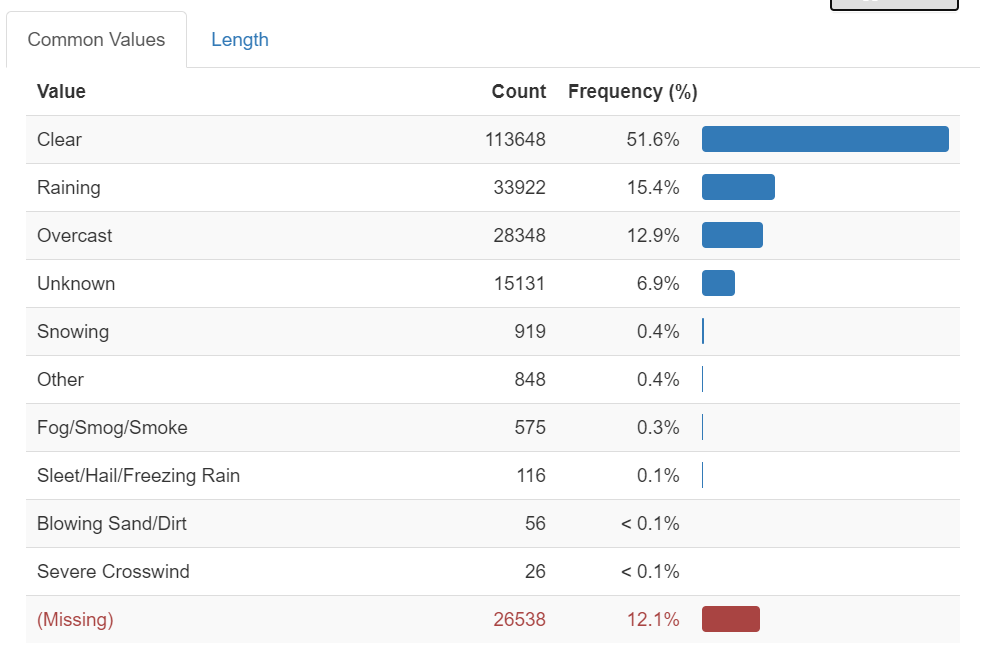
- **LIGHTCOND** - 12.1 missing.  Determine imputation method
- **COLLISIONTYPE** 12% missing.  Do all these 12% ers coincide?
- **UNDERINFL** - 12% missing.  What is 0? N and 0 are no and 1 and Y are yes?
- **ROADCOND** - 12% missing. Determine imputation method.
- **ST_COLDESC** - 12% missing 62 unique values - state text decriptions of accident
- **ST_COLCODE** - 4.3% number corresponding to state descriptions.  This variable was unsupported by Pandas profiling
- **JUNCTIONTYPE** - 5.4% missing 7 distinct values
- **LOCATION** - 2.1% missing.  25, 149 distinct.  Text description of location.
- **ADDRTYPE** - 1.7% missing.  3 types.  Mostly block
- **SEVERITYCODE** - <0.1% missing 5 distinct 
- **SDOT_COLDESC** - <0.1% missing. 39 distinct
- **SDOT_COLCODE** - same as above but with numbers as category instead of text
- **STATUS** - Matched and unmatched.  no missing  Mostly matched.
- **SEVERITYDESC** - 0 missing. 5 descriptions in text.
- **SEVERITYCODE** - same as above, but with numbers.  One observation is different between the two.
- **SEGLANEKEY** - numeric key for different 2101 distinct.  98+% are 0 while the rest are 4 and 5 digit numbers.  Likely the 0s are missing.  Not sure of value of this feature...
- **CROSSWALKKEY** - Similar situation to above. 2342 distinct values but 98+% 0s.  See how this connects to pedestrian collisions

### Boolean
- **HITPARKEDCAR** - yes no - Mostly nos

### Numeric
- **X** - Longitude - 3.4% missing for both... 24,491 distict for both need to figure imputation technique
- **Y** - - latitude - need to figure out what to do with these.  Create location key and groups?  
- **PERSONCOUNT** - Highly right skewed. May want to drop outlier.
- **PEDCOUNT** - Highly right skewed.  
- **PEDCYCLCOUNT** - Highly right skewed.  Oddly this feature was recognized as categorical in panda profiling
- **VEHCOUNT** - Right Skewed
- **INJURIES** - May need to remove outlier
- **SERIOUSINJURIES** - 
- **FATLITIES** - Were these the ones that changed?  The dups from REPORTNO because deaths reported later?

### Date
- **INCDATE** - Need to change format - Just date
- **INCDTTM** - Pull apart year, month, day of week, hour of day, minute(?)

So from pandas profiling we can see individually the breakdown of the certain features.  But we need to combine features to see if anything stands out where changing policy would make most impact.  The most collisions happen at the block addresstype, but what is the severity of each of those crashes?  Do they stand out as the most dangerous?  Or are intesections?  Next I want to try out some Sankey charts to visualize how the overall collisions feed out into more than one category....

So first we will do some groupbys using ADDRESSTYPE and SEVERITYDEC

In [10]:
severity_by_addrtype = df.groupby(['ADDRTYPE', 'SEVERITYDESC'])['OBJECTID'].count()
print(severity_by_addrtype)

ADDRTYPE      SEVERITYDESC                  
Alley         Injury Collision                     82
              Property Damage Only Collision      672
              Serious Injury Collision              5
              Unknown                             108
Block         Fatality Collision                  191
              Injury Collision                  30207
              Property Damage Only Collision    97080
              Serious Injury Collision           1513
              Unknown                           15181
Intersection  Fatality Collision                  156
              Injury Collision                  27881
              Property Damage Only Collision    37342
              Serious Injury Collision           1550
              Unknown                            4460
Name: OBJECTID, dtype: int64


So we can see that the stand out is property damage only in "Block." But now we have the numbers, let's put into a visualization...

In [13]:
##using tutorial from here: https://towardsdatascience.com/sankey-diagram-basics-with-pythons-plotly-7a13d557401a
import plotly.graph_objects as go

source = [0, 0, 0,          #All collisions
         1, 1, 1, 1, 1,     #Block
         2, 2, 2, 2, 2,     #Intersection
         3,3,3,3,3]         #Alley

target = [1,2,3,
         4,5,6,7,8,
         9, 10, 11, 12, 13,
         14, 15, 16, 17]

value = [144172, 71839, 867,
        97080, 30207, 15181, 1513, 191,
        37342, 27881, 4460, 1550, 156,
        672, 108, 82, 5]

label = ['All Collisions',
        'Block',
        'Intersection',
        'Alley',
        'Prop Damage Only',
        'Injury',
        'Unknown',
        'Serious',
        'Fatality',
        'Prop Damage Only',
        'Injury',
        'Unknown',
        'Serious',
        'Fatlaity',
        'Prop Damage Only',
        'Unknown',
        'Injury',
        'Serious Injury']

#data to dict, dict to sankey
link = dict(source = source, target = target, value = value)
node = dict(label = label, pad=15, thickness=5)
data = go.Sankey(link = link, node=node)
#plot
fig = go.Figure(data)
fig.show()

In [14]:
#This is great but I'd really rather see them all come to their approporiate places as SeverityDESC instead of three 
#times over...

source = [0, 0, 0,          #All collisions
         1, 1, 1, 1, 1,     #Block
         2, 2, 2, 2, 2,     #Intersection
         3,3,3,3,3,         #Alley
         4, 4, 4, 4, 4]     #SEVERITYDESC   

target = [1,2,3,
         4,5,6,7,8,
         9, 10, 11, 12, 13,
         14, 15, 16, 17,
         18, 19, 20, 21, 22]

value = [144172, 71839, 867,
        97080, 30207, 15181, 1513, 191,
        37342, 27881, 4460, 1550, 156,
        672, 108, 82, 5,
        136830, 58361, 21524, 3071, 347]

label = ['All Collisions',
        'Block',
        'Intersection',
        'Alley',
        'Prop Damage Only',
        'Injury',
        'Unknown',
        'Serious',
        'Fatality',
        'Prop Damage Only',
        'Injury',
        'Unknown',
        'Serious',
        'Fatlaity',
        'Prop Damage Only',
        'Unknown',
        'Injury',
        'Serious Injury',
        'Property Damage',
        'Inj',
        'Unk',
        'Ser',
        'Fatal']

#data to dict, dict to sankey
link = dict(source = source, target = target, value = value)
node = dict(label = label, pad=15, thickness=5)
data = go.Sankey(link = link, node=node)
#plot
fig = go.Figure(data)
fig.show()

Obviously something is wrong with this code.  Need to re-map the nodes....

In [15]:
#Trying out some visualizations. Using two features that I don't think are that useful, but they each only had two options, 
#so it was a simple first practice to understand what's happening
# This following one comes with help from this article:  https://towardsdatascience.com/5-visualisations-to-level-up-your-data-story-e131759c2f41
import plotly.express as px
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import pandas as pd

fig = go.Figure(go.Sunburst(
    labels=["Matched", "Unmatched", "N", "Y", 'N', 'Y'],
    parents=["","", "Matched", "Matched", 'Unmatched', 'Unmatched'],
    values=np.append(
        df.groupby('STATUS').OBJECTID.count().values,
        df.groupby(['STATUS', 'HITPARKEDCAR']).OBJECTID.count().values),
    marker=dict(colors=px.colors.sequential.Emrld)),
                layout=go.Layout(paper_bgcolor='rgba(0,0,0,0)',
                                 plot_bgcolor='rgba(0,0,0,0)'))

fig.update_layout(margin=dict(t=30, l=1, r=1, b=1),
                  title_text='Count by Status and Hit Parked Car')


The above worked because STATUS had no missing data.  In order to run these visualizations with more helpful features, we would have to remove of fill the missing values.  

In [16]:
fig = px.sunburst(df, path=['ADDRTYPE', 'SEVERITYDESC', 'WEATHER'], values='OBJECTID')
fig.show

ValueError: ('None entries cannot have not-None children', ADDRTYPE                      nan
SEVERITYDESC     Injury Collision
WEATHER         Blowing Sand/Dirt
Name: 24143, dtype: object)